In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('features_56x56.csv')

In [3]:
df

,f0,f1,f2,f3,f4,f5,f6,f7,f8,f9,...,f3127,f3128,f3129,f3130,f3131,f3132,f3133,f3134,f3135,label
0,0.525490,0.494118,0.509804,0.501961,0.498039,0.529412,0.482353,0.478431,0.450980,0.447059,...,0.560784,0.568627,0.556863,0.564706,0.560784,0.568627,0.556863,0.564706,0.560784,0
1,0.568627,0.568627,0.568627,0.568627,0.564706,0.560784,0.556863,0.552941,0.545098,0.537255,...,0.474510,0.482353,0.490196,0.494118,0.498039,0.501961,0.454902,0.501961,0.454902,0
2,0.560784,0.564706,0.556863,0.568627,0.560784,0.564706,0.556863,0.568627,0.560784,0.564706,...,0.450980,0.478431,0.482353,0.529412,0.498039,0.501961,0.509804,0.494118,0.525490,0
3,0.454902,0.501961,0.454902,0.501961,0.498039,0.494118,0.490196,0.482353,0.474510,0.466667,...,0.545098,0.552941,0.556863,0.560784,0.564706,0.568627,0.568627,0.568627,0.568627,0
4,0.454902,0.454902,0.454902,0.454902,0.454902,0.454902,0.549020,0.537255,0.552941,0.552941,...,0.564706,0.560784,0.564706,0.560784,0.568627,0.560784,0.564706,0.556863,0.568627,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,0.470588,0.529412,0.470588,0.525490,0.521569,0.517647,0.509804,0.501961,0.494118,0.486275,...,0.572549,0.580392,0.588235,0.592157,0.596078,0.600000,0.600000,0.600000,0.600000,1
316,0.470588,0.470588,0.470588,0.470588,0.470588,0.470588,0.572549,0.564706,0.572549,0.576471,...,0.600000,0.592157,0.596078,0.588235,0.600000,0.592157,0.592157,0.588235,0.600000,1
317,0.588235,0.588235,0.588235,0.588235,0.584314,0.580392,0.572549,0.564706,0.560784,0.545098,...,0.521569,0.529412,0.533333,0.541176,0.545098,0.462745,0.549020,0.545098,0.552941,1
318,0.600000,0.588235,0.592157,0.592157,0.600000,0.588235,0.596078,0.592157,0.600000,0.588235,...,0.572549,0.564706,0.572549,0.470588,0.470588,0.470588,0.470588,0.470588,0.470588,1


In [4]:
X = df.drop(columns=['label'])
Y = df['label']

In [5]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2, random_state=42)

In [6]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_scaled = pd.DataFrame(sc.fit_transform(X_train), columns=X_train.columns)
X_test_scaled = pd.DataFrame(sc.fit_transform(X_test), columns=X_test.columns)

In [7]:
from sklearn.decomposition import PCA
pca = PCA(n_components=None)
X_train_trf = pca.fit_transform(X_train_scaled)
X_test_trf = pca.transform(X_test_scaled)

In [8]:
np.cumsum(pca.explained_variance_ratio_)

array([0.61948516, 0.7567022 , 0.88997782, 0.91483051, 0.93427991,
       0.95319568, 0.96517144, 0.97433699, 0.98231778, 0.9836708 ,
       0.98496596, 0.98566137, 0.98629   , 0.98689838, 0.98748449,
       0.98800008, 0.98845128, 0.98886431, 0.98924096, 0.98961283,
       0.98996681, 0.99030864, 0.99063082, 0.99093883, 0.99123348,
       0.99151474, 0.99179165, 0.99206201, 0.99229402, 0.99252246,
       0.99272543, 0.99291624, 0.99309264, 0.99326295, 0.99343123,
       0.99359005, 0.99374718, 0.99389516, 0.99403551, 0.99417491,
       0.99431063, 0.99444276, 0.99457032, 0.99469491, 0.9948159 ,
       0.9949314 , 0.99504395, 0.99514857, 0.99524901, 0.9953456 ,
       0.99544052, 0.99552793, 0.99561329, 0.99569681, 0.99577936,
       0.99585932, 0.9959379 , 0.99601489, 0.99608967, 0.99616346,
       0.99623527, 0.99630636, 0.99637661, 0.9964456 , 0.99651326,
       0.9965791 , 0.99664321, 0.99670685, 0.99676965, 0.99683162,
       0.99689269, 0.99695107, 0.99700892, 0.99706544, 0.99712

In [9]:
#Moving forward with 9 components as it explains over 98% variance of the data

In [10]:
pca = PCA(n_components=9)
X_train_trf = pca.fit_transform(X_train_scaled)
X_test_trf = pca.transform(X_test_scaled)

In [11]:
X_train_trf.shape

(256, 9)

In [12]:
X_test_trf.shape

(64, 9)

In [42]:
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, classification_report

# Create the model
lgbm_clf = LGBMClassifier(
    n_estimators=500,       # number of boosting rounds
    max_depth=-1,           # no limit on tree depth
    learning_rate=0.0008,      # you can tune this
    random_state=42         # for reproducibility
)

# Train the model
lgbm_clf.fit(X_train_trf, y_train)

# Predict on train and test data
y_train_pred = lgbm_clf.predict(X_train_trf)
y_test_pred = lgbm_clf.predict(X_test_trf)

# Evaluate
print("Training Accuracy:", accuracy_score(y_train, y_train_pred))
print("Testing Accuracy:", accuracy_score(y_test, y_test_pred))
print("\nClassification Report:\n", classification_report(y_test, y_test_pred))

[LightGBM] [Info] Number of positive: 104, number of negative: 152
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000179 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 777
[LightGBM] [Info] Number of data points in the train set: 256, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406250 -> initscore=-0.379490
[LightGBM] [Info] Start training from score -0.379490
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


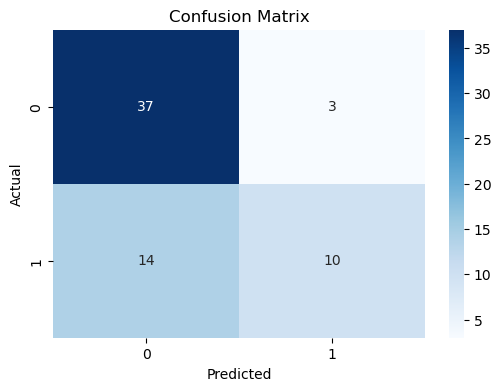

In [43]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compute confusion matrix
cm = confusion_matrix(y_test, y_test_pred)

# Plot using seaborn
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


In [44]:
from lightgbm import LGBMClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer, recall_score

# Define the model
lgbm_clf = LGBMClassifier(random_state=42)

# Define hyperparameter grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7, -1],
    'num_leaves': [15, 31, 63],
    'min_child_samples': [10, 20, 30]
}

# Use recall as scoring
scorer = make_scorer(recall_score)

# Grid search
grid_search = GridSearchCV(
    estimator=lgbm_clf,
    param_grid=param_grid,
    scoring=scorer,
    cv=5,
    n_jobs=-1,
    verbose=1
)

# Fit
grid_search.fit(X_train_trf, y_train)

# Best model
best_lgbm = grid_search.best_estimator_

print("Best Parameters:", grid_search.best_params_)

Fitting 5 folds for each of 324 candidates, totalling 1620 fits
[LightGBM] [Info] Number of positive: 83, number of negative: 122
[LightGBM] [Info] Number of positive: 83, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003053 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001571 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 630
[LightGBM] [Info] Total Bins 625
[LightGBM] [Info] Number of data points in the train set: 205, number of used features: 9
[LightGBM] [Info] Number of data points in the train set: 204, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.404878 -> initscore=-0.385180
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406863 -> initscore=-0.376950
[LightGBM]

/opt/anaconda3/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [45]:
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, classification_report

# Initialize model with best params
best_lgbm = LGBMClassifier(
    learning_rate=0.1,
    max_depth=7,
    min_child_samples=10,
    n_estimators=100,
    num_leaves=31,
    random_state=42
)

# Train the model
best_lgbm.fit(X_train_trf, y_train)

# Predict
y_train_pred = best_lgbm.predict(X_train_trf)
y_test_pred = best_lgbm.predict(X_test_trf)

# Evaluate
print("Training Accuracy:", accuracy_score(y_train, y_train_pred))
print("Testing Accuracy:", accuracy_score(y_test, y_test_pred))
print("\nClassification Report:\n", classification_report(y_test, y_test_pred))

[LightGBM] [Info] Number of positive: 104, number of negative: 152
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 777
[LightGBM] [Info] Number of data points in the train set: 256, number of used features: 9
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.406250 -> initscore=-0.379490
[LightGBM] [Info] Start training from score -0.379490
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

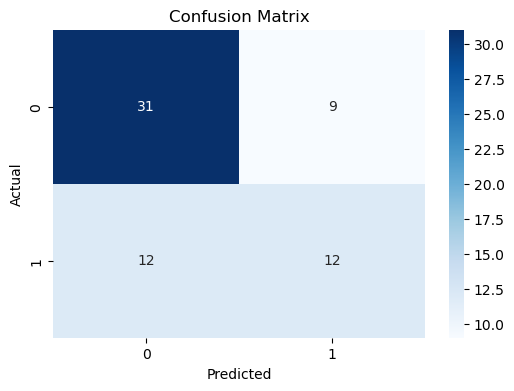

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Compute confusion matrix
cm = confusion_matrix(y_test, y_test_pred)

# Plot
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=[0, 1], yticklabels=[0, 1])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [47]:
#Consider the first model as the best one from LightGBM